# CONDITIONAL VAE

Library imports

In [1]:
import torch
import torch.nn as nn
from torchvision import datasets, transforms
import torchvision.utils as vutils
from torch.utils.data import Dataset
import torch.nn.functional as F

import numpy as np
import matplotlib.pylab as plt
import tqdm as tqdm #overhead of 60ns
from torchsummary import summary
import sys
import math
from skimage import io, img_as_ubyte
from skimage.transform import resize
import os
import pandas as pd
import requests


ModuleNotFoundError: No module named 'torchsummary'

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [3]:
zip_path = '/content/drive/My Drive/multimodal_dataset.zip'
!cp "{zip_path}" .
!unzip -q multimodal_dataset.zip
!rm multimodal_dataset.zip

Creation of class conditional VAE

In [4]:
class Cvae(nn.Module):
    def __init__(self, nc, nef, ndf, latent_space_size, i_mlp=1160, o_mlp=1000, eps_beta=1e-6, eps_gamma=1e-6):
        #Encoder
        super(Cvae, self).__init__()
        self.nc = nc
        self.nef = nef
        self.ndf = ndf
        
        self.conv1 = nn.Conv2d(nc,nef,3,2,1)
        self.bn1 = nn.BatchNorm2d(nef)
        self.conv2 = nn.Conv2d(nef,nef*2,3,2,1)
        self.bn2 = nn.BatchNorm2d(nef*2)   
        self.conv3 = nn.Conv2d(nef*2,nef*2,3,2,1)
        self.bn3 = nn.BatchNorm2d(nef*2)   
        self.conv4 = nn.Conv2d(nef*2,nef*4,3,1,1)
        
        #Decoder        
        self.reconv1 = self.resize_conv(ndf*4,ndf*2,3)
        self.bn4 = nn.BatchNorm2d(ndf*2, affine=False)
        self.reconv2 = self.resize_conv(ndf*2,ndf*2,3)
        self.bn5 = nn.BatchNorm2d(ndf*2, affine=False)  
        self.reconv3 = self.resize_conv(ndf*2,ndf,3)
        self.bn6 = nn.BatchNorm2d(ndf, affine=False)
        self.reconv4 = nn.Conv2d(ndf,nc,3,1,1)

        # MLP
        self.lin1_mlp = nn.Linear(i_mlp, i_mlp - abs(i_mlp - o_mlp)//3)
        self.bn1_mlp = nn.BatchNorm1d(i_mlp - abs(i_mlp - o_mlp)//3)
        self.lin2_mlp = nn.Linear(i_mlp - abs(i_mlp - o_mlp)//3, i_mlp - (abs(i_mlp - o_mlp)//3)*2)
        self.bn2_mlp = nn.BatchNorm1d(i_mlp - (abs(i_mlp - o_mlp)//3)*2)
        self.lin3_mlp = nn.Linear(i_mlp - (abs(i_mlp - o_mlp)//3)*2, o_mlp)
        self.bn3_mlp = nn.BatchNorm1d(o_mlp)

        # Activation - Layer 1 - Gamma
        self.lin1_a1_gamma = nn.Linear(o_mlp, (o_mlp + ndf*2) // 2)
        self.bn1_a1_gamma = nn.BatchNorm1d((o_mlp + ndf*2) // 2)
        self.lin2_a1_gamma = nn.Linear((o_mlp + ndf*2) // 2, ndf*2)
        self.bn2_a1_gamma = nn.BatchNorm1d(ndf*2)
        # Activation - Layer 2 - Gamma
        self.lin1_a2_gamma = nn.Linear(o_mlp, (o_mlp + ndf*2) // 2)
        self.bn1_a2_gamma = nn.BatchNorm1d((o_mlp + ndf*2) // 2)
        self.lin2_a2_gamma = nn.Linear((o_mlp + ndf*2) // 2, ndf*2)
        self.bn2_a2_gamma = nn.BatchNorm1d(ndf*2)
        # Activation - Layer 3 - Gamma
        self.lin1_a3_gamma = nn.Linear(o_mlp, (o_mlp + ndf) // 2)
        self.bn1_a3_gamma = nn.BatchNorm1d((o_mlp + ndf) // 2)
        self.lin2_a3_gamma = nn.Linear((o_mlp + ndf) // 2, ndf)
        self.bn2_a3_gamma = nn.BatchNorm1d(ndf)


        # Activation - Layer 1 - Beta
        self.lin1_a1_beta = nn.Linear(o_mlp, (o_mlp + ndf * 2) // 2)
        self.bn1_a1_beta = nn.BatchNorm1d((o_mlp + ndf * 2) // 2)
        self.lin2_a1_beta = nn.Linear((o_mlp + ndf * 2) // 2, ndf * 2)
        self.bn2_a1_beta = nn.BatchNorm1d(ndf * 2)
        # Activation - Layer 2 - Beta
        self.lin1_a2_beta = nn.Linear(o_mlp, (o_mlp + ndf * 2) // 2)
        self.bn1_a2_beta = nn.BatchNorm1d((o_mlp + ndf * 2) // 2)
        self.lin2_a2_beta = nn.Linear((o_mlp + ndf * 2) // 2, ndf * 2)
        self.bn2_a2_beta = nn.BatchNorm1d(ndf * 2)
        # Activation - Layer 3 - Beta
        self.lin1_a3_beta = nn.Linear(o_mlp, (o_mlp + ndf) // 2)
        self.bn1_a3_beta = nn.BatchNorm1d((o_mlp + ndf) // 2)
        self.lin2_a3_beta = nn.Linear((o_mlp + ndf) // 2, ndf)
        self.bn2_a3_beta = nn.BatchNorm1d(ndf)


        self.leakyrelu = nn.LeakyReLU()
        self.relu = nn.ReLU()
        self.sigmoid = nn.Sigmoid()
        #self.do = nn.Dropout(0)
        
        #Linear
        self.f1 = nn.Linear(128*16*16, latent_space_size)
        self.f2 = nn.Linear(128*16*16, latent_space_size)
        self.d1 = nn.Linear(latent_space_size, 128*16*16)
        
        #self.init_weights()
        
    
    def forward (self, cover, audio):
        mu, logvar = self.encoder(cover)
        z = self.reparametrize(mu, logvar)
        x_ = self.decoder(z, audio)   
                 
        return mu, logvar, x_
    
    def encoder(self, x):
        #layer 1
        x = self.conv1(x)
        x = self.leakyrelu(self.bn1(x))
        #layer 2
        x = self.conv2(x)
        x = self.leakyrelu(self.bn2(x))
        #layer 3
        x = self.conv3(x)
        x = self.leakyrelu(self.bn3(x))
        #layer 4
        x = self.leakyrelu(self.conv4(x))
        x = x.view(x.size(0),-1)
        
        return self.f1(x), self.f2(x)
    
    def reparametrize(self, mu, logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std) #Returns tensor same size as inpufilled with rand nº from Udistribution on interval [0,1)
        return mu+std*eps
        
        
    def decoder(self, z, audio):
        # MLP
        x = self.relu(self.bn1_mlp(self.lin1_mlp(audio)))
        x = self.relu(self.bn2_mlp(self.lin2_mlp(x)))
        o_mlp = self.bn3_mlp(self.lin3_mlp(x))

        # Activation 1
        beta1 = self.relu(self.bn1_a1_beta(self.lin1_a1_beta(o_mlp)))
        beta1 = self.lin2_a1_beta(beta1)
        gamma1 = self.relu(self.bn1_a1_gamma(self.lin1_a1_gamma(o_mlp)))
        gamma1 = self.lin2_a1_gamma(gamma1)

        # Activation 2
        beta2 = self.relu(self.bn1_a2_beta(self.lin1_a2_beta(o_mlp)))
        beta2 = self.lin2_a2_beta(beta2)
        gamma2 = self.relu(self.bn1_a2_gamma(self.lin1_a2_gamma(o_mlp)))
        gamma2 = self.lin2_a2_gamma(gamma2)

        # Activation 3
        beta3 = self.relu(self.bn1_a3_beta(self.lin1_a3_beta(o_mlp)))
        beta3 = self.lin2_a3_beta(beta3)
        gamma3 = self.relu(self.bn1_a3_gamma(self.lin1_a3_gamma(o_mlp)))
        gamma3 = self.lin2_a3_gamma(gamma3)

        #layer 5
        x = self.d1(z)
        x = x.view(x.size(0), 128, 16, 16)
        x = self.leakyrelu((beta1.view(x.size(0), -1, 1, 1)) * self.bn4(self.reconv1(x)) + gamma1.view(x.size(0), -1, 1, 1))
        #layer 6
        x = self.leakyrelu((beta2.view(x.size(0), -1, 1, 1)) * self.bn5(self.reconv2(x)) + gamma2.view(x.size(0), -1, 1, 1))
        #layer 7
        x = self.leakyrelu((beta3.view(x.size(0), -1, 1, 1)) * self.bn6(self.reconv3(x)) + gamma3.view(x.size(0), -1, 1, 1))
        #Layer 8
        x = self.sigmoid(self.reconv4(x))

        return x
       
    #Resize convolution layers function     
    def resize_conv(self, i, o, k):       
        reconv = nn.Sequential(nn.Upsample(scale_factor=2, mode='nearest'),
                            nn.ReflectionPad2d(1),
                            nn.Conv2d(i, o,
                            kernel_size=k, stride=1, padding=0),)
        return reconv
    

Let's define some functions that we will need in the like our custom Dataset function to load images and audio features and a weight initialization function

In [5]:
class concatDataset(Dataset):
    def __init__(self, audio_npy, cover_dataset):
        super(concatDataset, self).__init__()
        self.dataset_audio = torch.from_numpy(np.load(audio_npy))
        self.dataset_cover = cover_dataset
    def __getitem__(self, index):
        audio = self.dataset_audio[index]
        cover = self.dataset_cover[index]
        return audio, cover

    def __len__(self):
        return len(self.dataset_audio)


def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    if classname.find('BatchNorm')!= -1  and m.affine == True:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)
    if classname.find('Linear') != -1:
        stdv = 1. / math.sqrt(m.weight.size(1))
        m.weight.data.uniform_(-stdv, stdv)
        if m.bias is not None:
            m.bias.data.uniform_(-stdv, stdv)


### Download dataset
Dataset download

In [6]:
batch = 64

# TRAIN SET --------------------------------------------------------------------
#Cover
cover_train = 'multimodal_dataset/audio-cover_dataset/cover/train'
train_dataset_cover = datasets.ImageFolder(root=cover_train,
                                transform=transforms.Compose([
                               transforms.ToTensor(),
                           ]))
torch.save(train_dataset_cover, 'train_dataset_cover.pt')
train_dataset_cover = torch.load('train_dataset_cover.pt')

#Audio
audio_train = 'multimodal_dataset/audio-cover_dataset/X_train_audio.npy'

train_dataset_mixed = concatDataset(audio_train, train_dataset_cover)
train_loader = torch.utils.data.DataLoader(dataset=train_dataset_mixed, batch_size=batch, shuffle=False, drop_last=True)


# VALIDATION SET----------------------------------------------------------------
#Cover
cover_val = 'multimodal_dataset/audio-cover_dataset/cover/val'
val_dataset_cover = datasets.ImageFolder(root=cover_val,
                                transform=transforms.Compose([
                               transforms.ToTensor(),
                           ]))
torch.save(val_dataset_cover, 'val_dataset_cover.pt')
val_dataset_cover = torch.load('val_dataset_cover.pt')

#Audio
audio_val = 'multimodal_dataset/audio-cover_dataset/X_val_audio.npy'

val_dataset_mixed = concatDataset(audio_val, val_dataset_cover)
val_loader = torch.utils.data.DataLoader(dataset=val_dataset_mixed, batch_size=batch, shuffle=True, drop_last=True)

       

Let's check if data is loading correctly

In [ ]:
data = next(iter(train_dataset_mixed))
audio, cover = data
print(audio.size())
cover_x, _ = cover
print(cover_x.size())
cover_npy = cover_x.permute(1,2,0).numpy()

torch.Size([1160])
torch.Size([3, 128, 128])


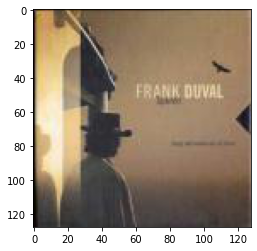

In [ ]:
plt.imshow(cover_npy)

### Model, criterion and optimizer initilization

In [7]:
# ------------------------------------------ DEFINE MODEL -------------------------------------------------#
torch.manual_seed(42)
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")

model = Cvae(3,32,32, 500).to(device)
model.apply(weights_init)
# ------------------------------------------- OPTIMIZER ---------------------------------------------------#
reconst_error = nn.BCELoss()
reconst_error.size_average = False
lr = 1e-3
weight_decay = 0
optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)

# ------------------------------------------ CRITERION -----------------------------------------------------#
# VAE loss
def loss_vae(mu, logvar, x, y):
    bce = F.binary_cross_entropy(x,y,reduction='sum')
    dkl = -0.5*torch.sum(1 + logvar - mu.pow(2) - logvar.exp()) 
    
    return bce, dkl, bce+dkl

### Training



  0%|          | 0/50 [00:00<?, ?it/s]

TRAINING... Epoch:  8
Iteration: 0/1620
Loss: 1595527.0000, BCE Loss: 1562914.3750, DKL Loss: 32612.6270


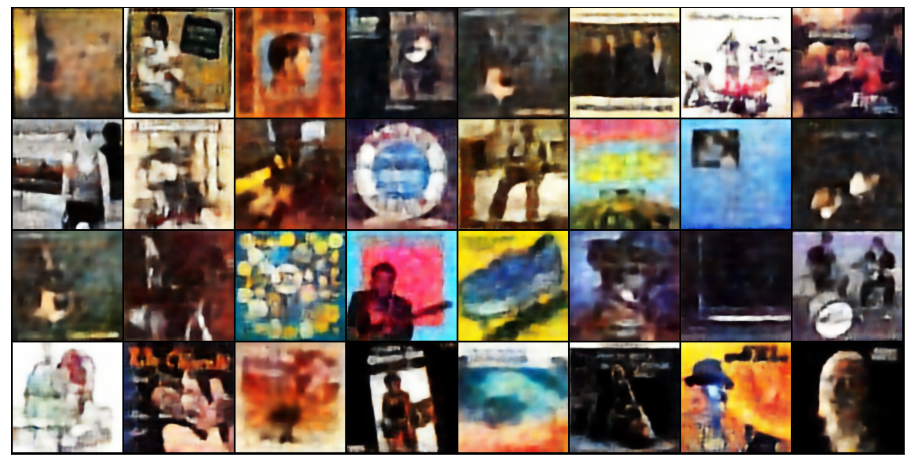

Iteration: 150/1620
Loss: 1583895.6250, BCE Loss: 1553873.0000, DKL Loss: 30022.5703


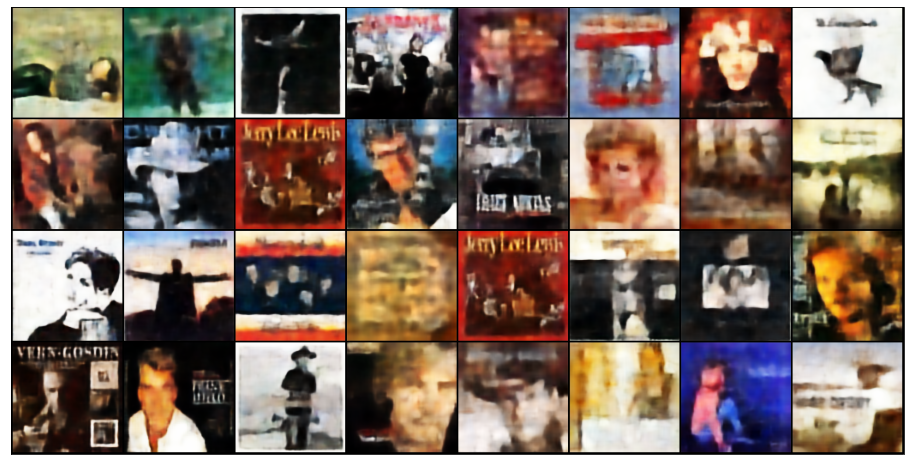

Iteration: 300/1620
Loss: 1377905.2500, BCE Loss: 1347127.2500, DKL Loss: 30777.9805


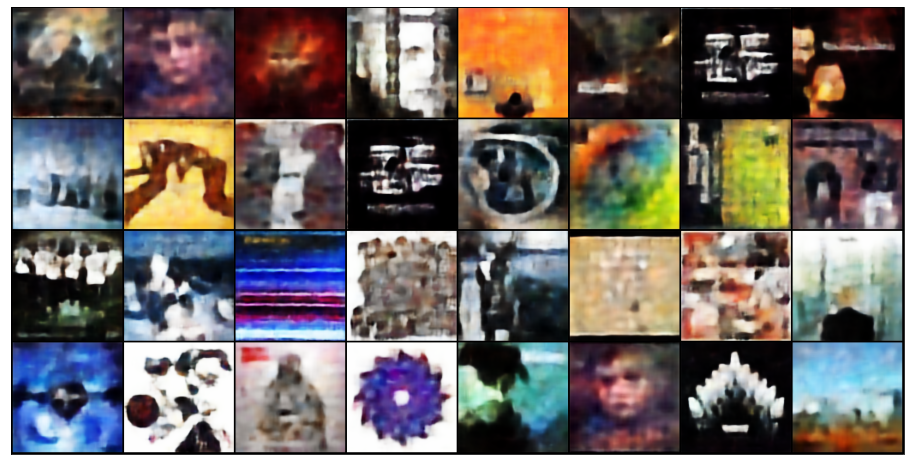

Iteration: 450/1620
Loss: 1562128.0000, BCE Loss: 1532673.0000, DKL Loss: 29454.9648


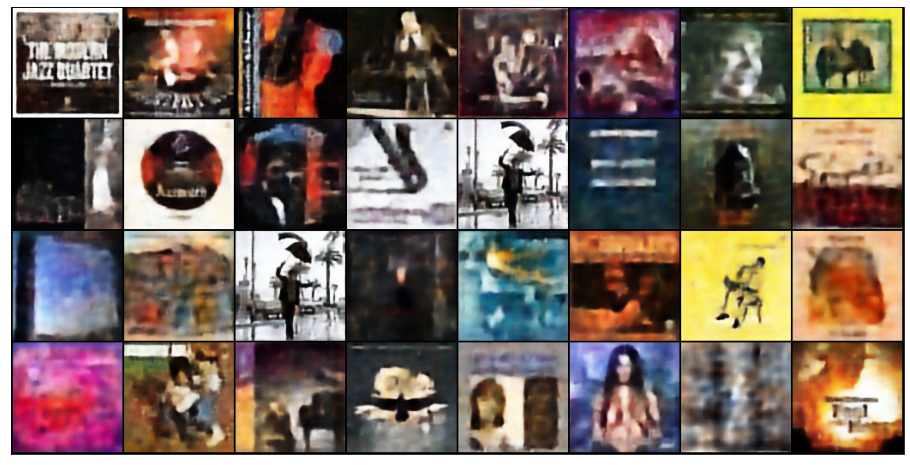

Iteration: 600/1620
Loss: 1524325.5000, BCE Loss: 1493364.0000, DKL Loss: 30961.4922


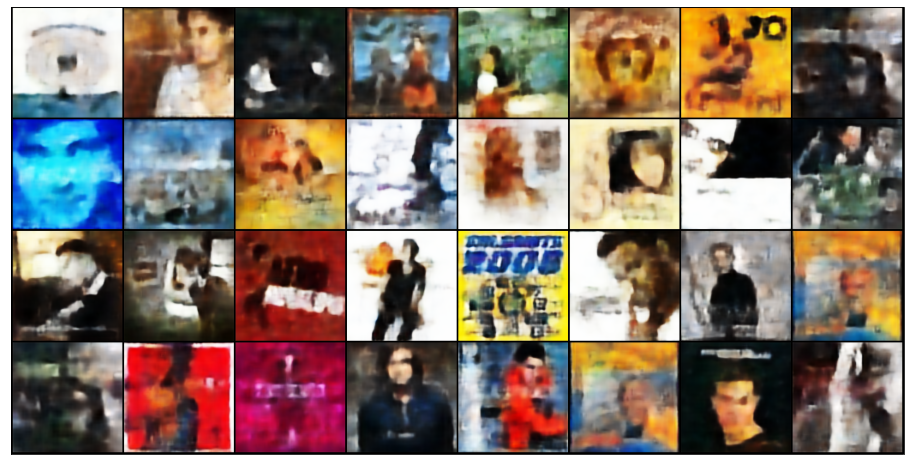

Iteration: 750/1620
Loss: 1485846.8750, BCE Loss: 1457489.2500, DKL Loss: 28357.5820


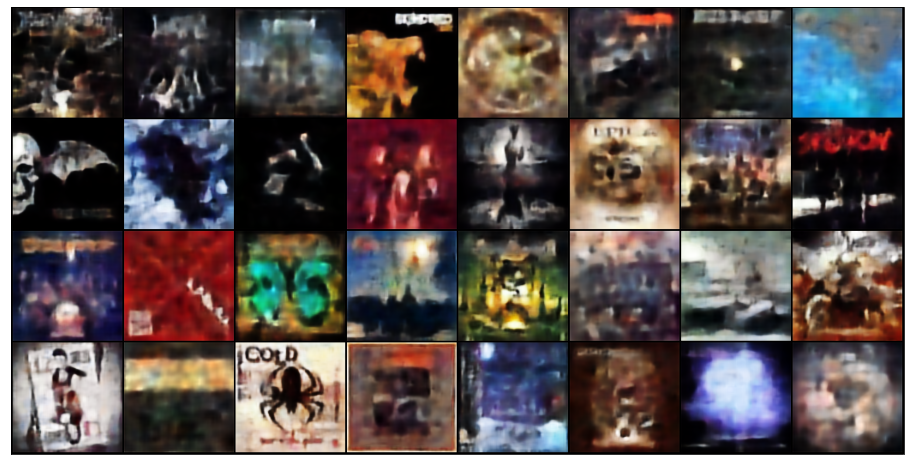

Iteration: 900/1620
Loss: 1551518.5000, BCE Loss: 1522991.2500, DKL Loss: 28527.2695


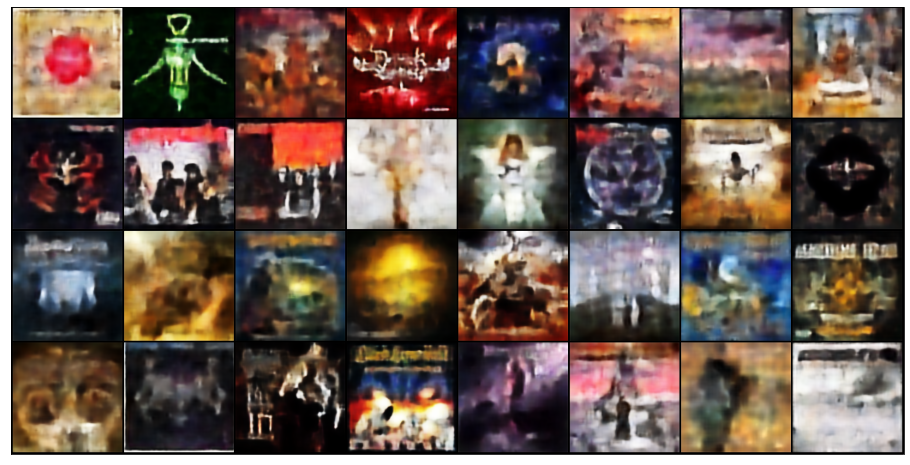

Iteration: 1050/1620
Loss: 1541875.5000, BCE Loss: 1508672.7500, DKL Loss: 33202.6875


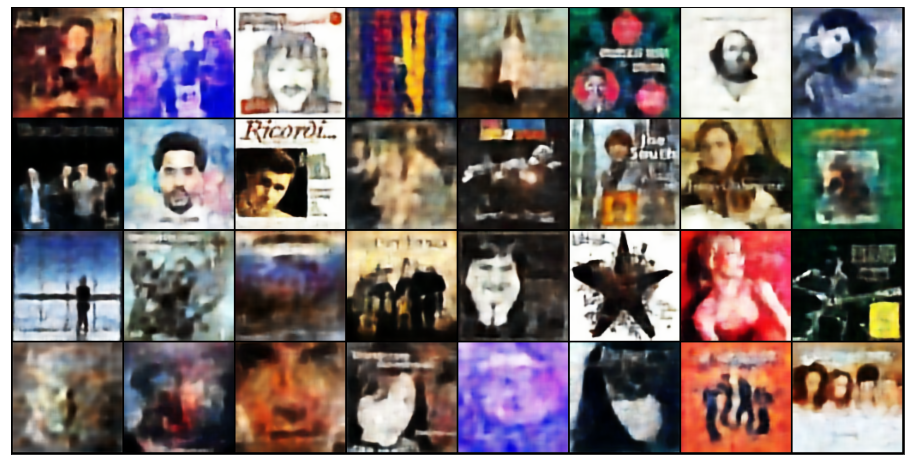

Iteration: 1200/1620
Loss: 1476443.3750, BCE Loss: 1442548.8750, DKL Loss: 33894.5195


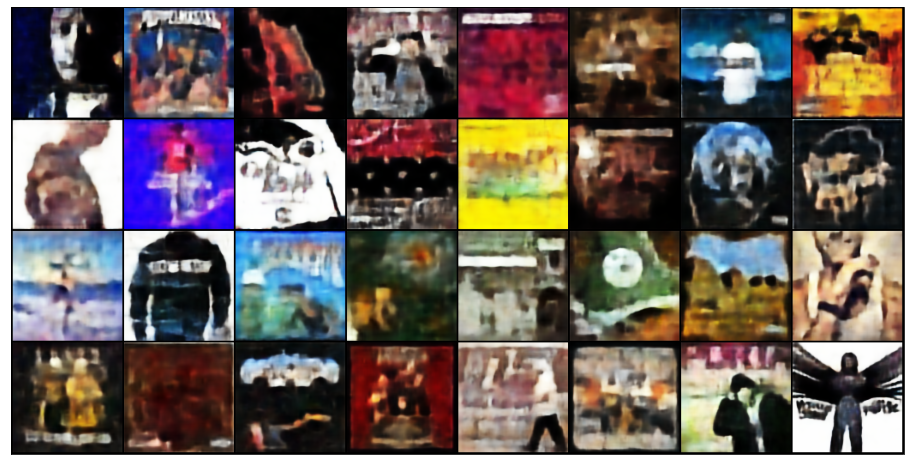

Iteration: 1350/1620
Loss: 1449296.5000, BCE Loss: 1418034.2500, DKL Loss: 31262.2441


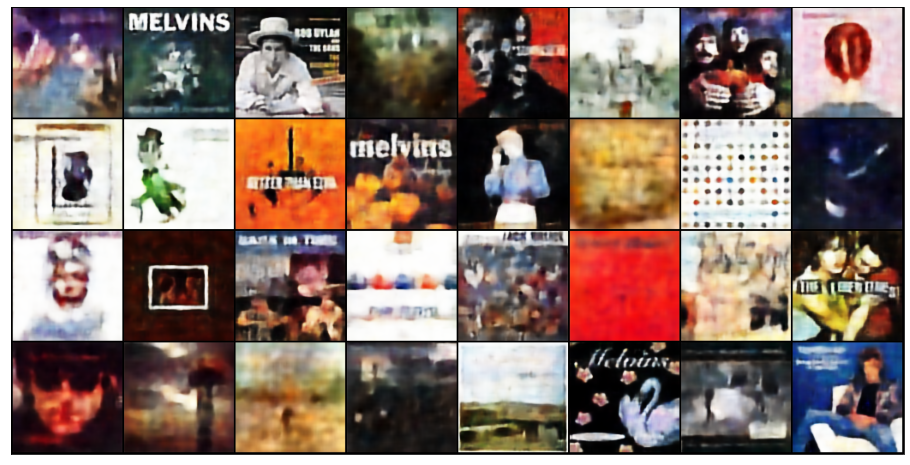

Iteration: 1500/1620
Loss: 1496081.2500, BCE Loss: 1462589.7500, DKL Loss: 33491.5352


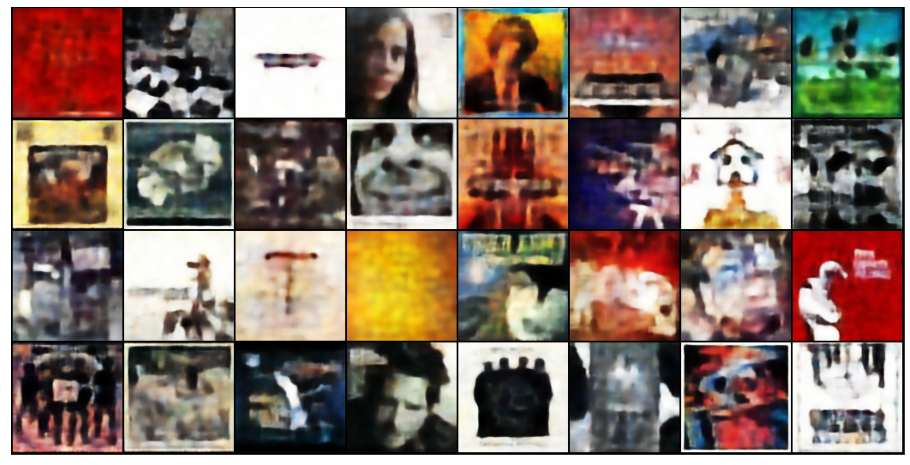

EVALUATING...
Iteration: 0/127
Iteration: 48/127
Iteration: 96/127
tensor(1570767.1250)
[tensor(1668636.1250), tensor(1588905.6250), tensor(1570767.1250), tensor(1604790.2500), tensor(1609906.1250), tensor(1582542.2500), tensor(1583079.5000), tensor(1581197.6250), tensor(1580954.2500), tensor(1575150.5000), tensor(1648844.3750), tensor(1614905.1250), tensor(1596252.), tensor(1621397.8750, device='cuda:0')]
8
1




  2%|▏         | 1/50 [05:13<4:15:59, 313.47s/it]

8
TRAINING... Epoch:  9
Iteration: 0/1620
Loss: 1588401.0000, BCE Loss: 1554927.0000, DKL Loss: 33474.0234


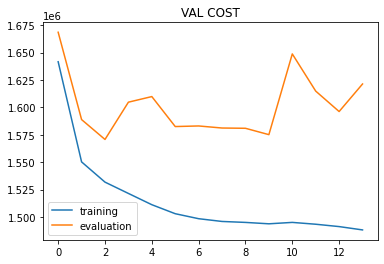

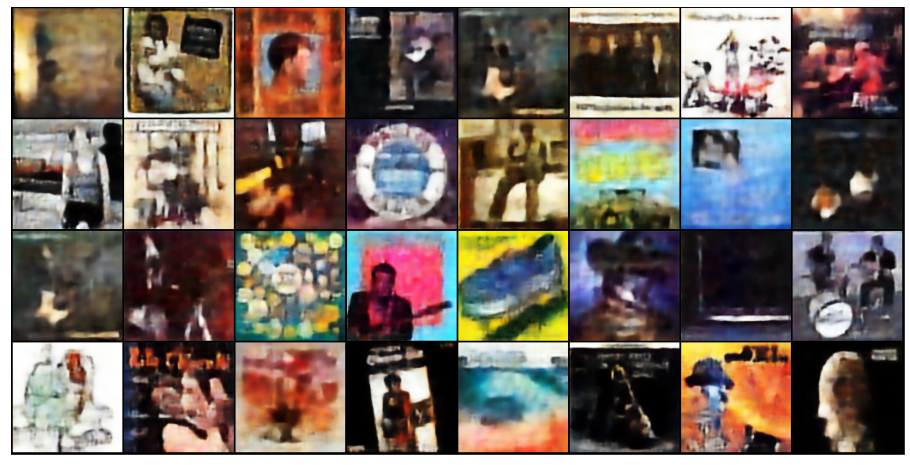

Iteration: 150/1620
Loss: 1582243.0000, BCE Loss: 1552309.0000, DKL Loss: 29933.9883


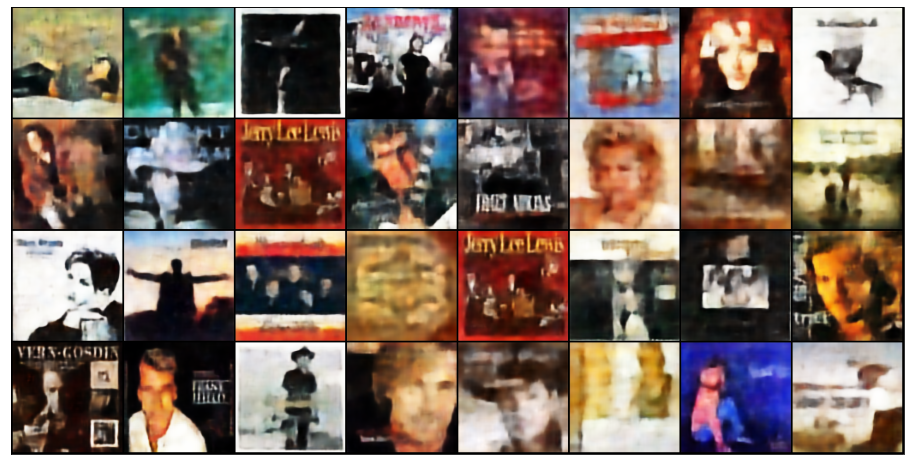

Iteration: 300/1620
Loss: 1375913.8750, BCE Loss: 1345011.1250, DKL Loss: 30902.7637


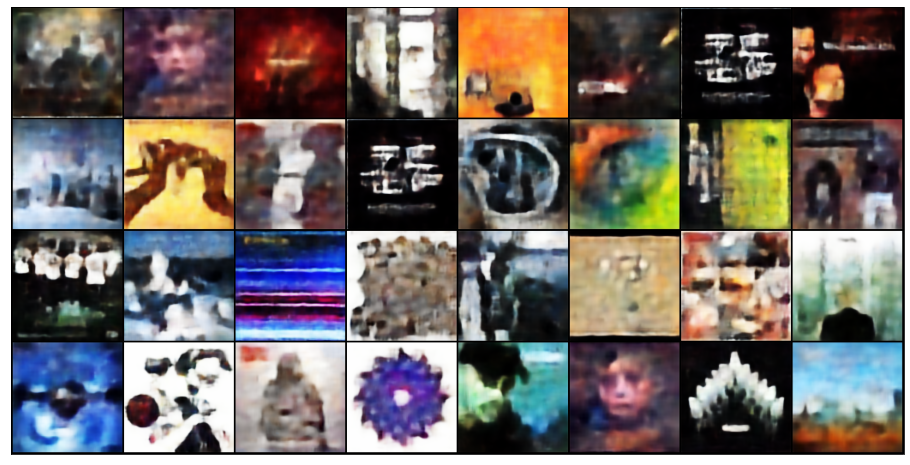

Iteration: 450/1620
Loss: 1560328.2500, BCE Loss: 1530900.3750, DKL Loss: 29427.8555


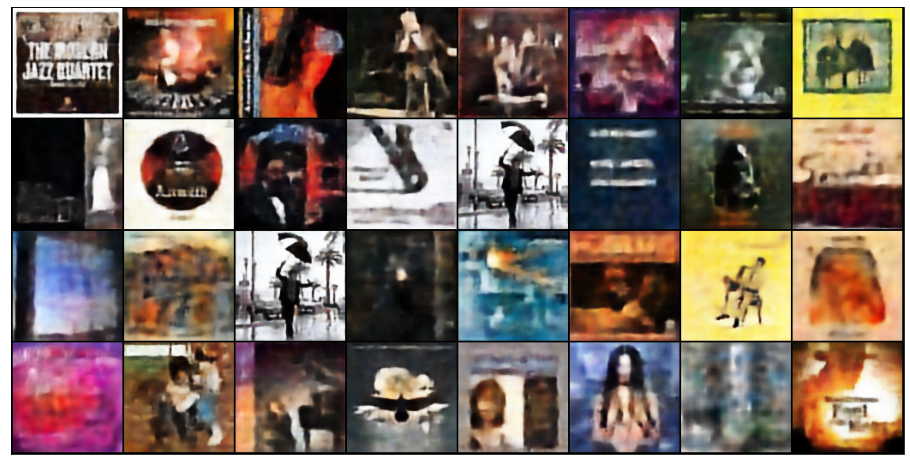

Iteration: 600/1620
Loss: 1522072.3750, BCE Loss: 1491071.2500, DKL Loss: 31001.1152


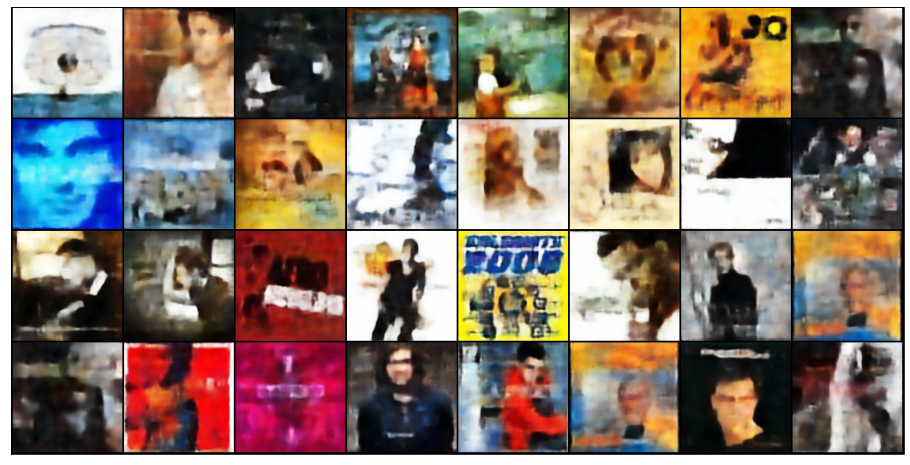

Iteration: 750/1620
Loss: 1484135.6250, BCE Loss: 1455757.2500, DKL Loss: 28378.4062


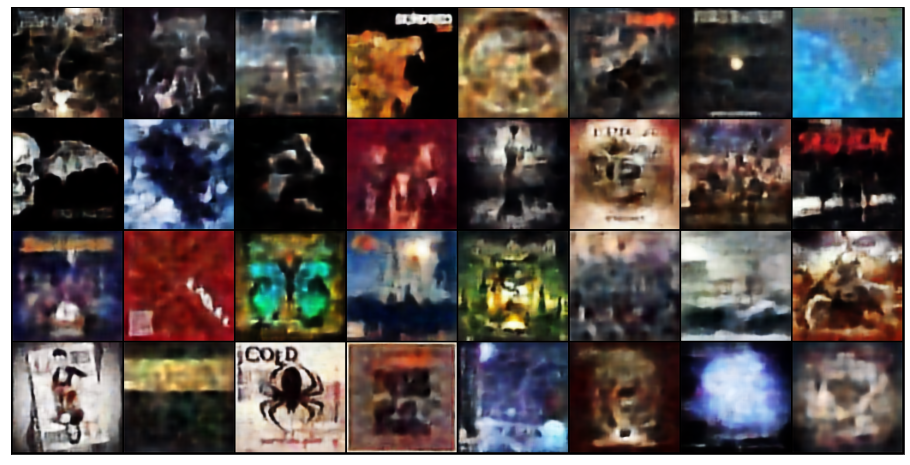

Iteration: 900/1620
Loss: 1550818.7500, BCE Loss: 1522259.2500, DKL Loss: 28559.5469


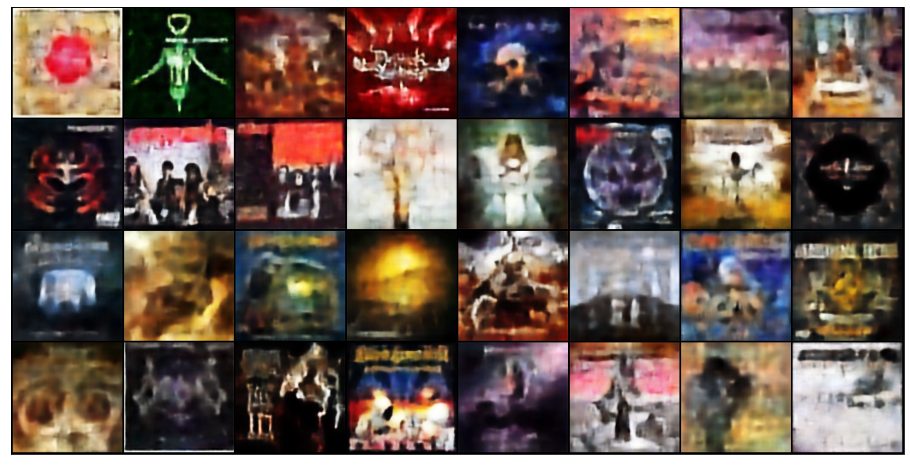

Iteration: 1050/1620
Loss: 1540805.3750, BCE Loss: 1507746.7500, DKL Loss: 33058.6094


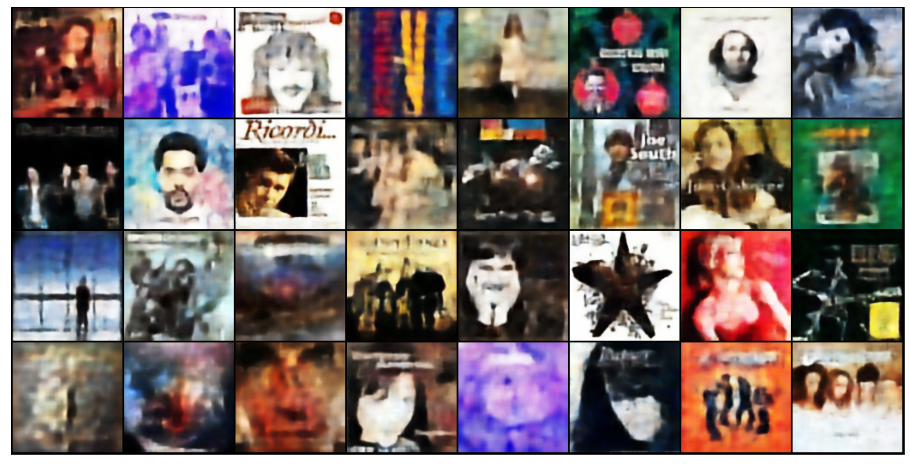

Iteration: 1200/1620
Loss: 1475222.8750, BCE Loss: 1441314.1250, DKL Loss: 33908.7812


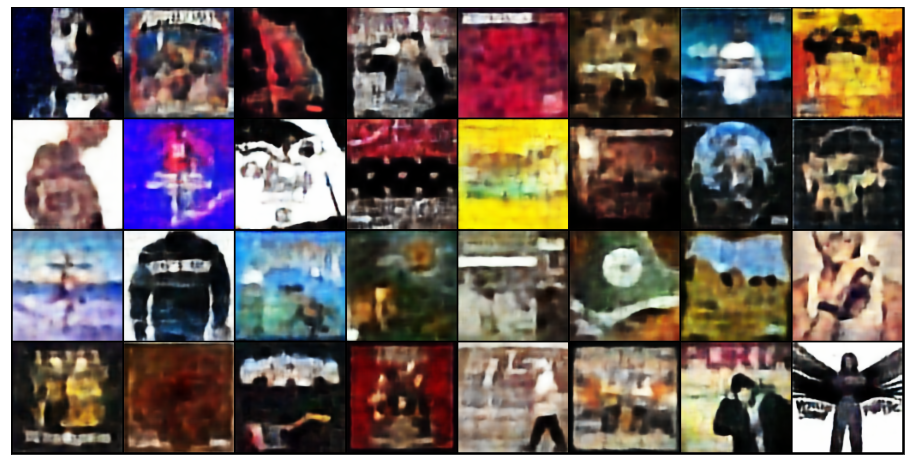

Iteration: 1350/1620
Loss: 1448190.2500, BCE Loss: 1416721.2500, DKL Loss: 31469.0117


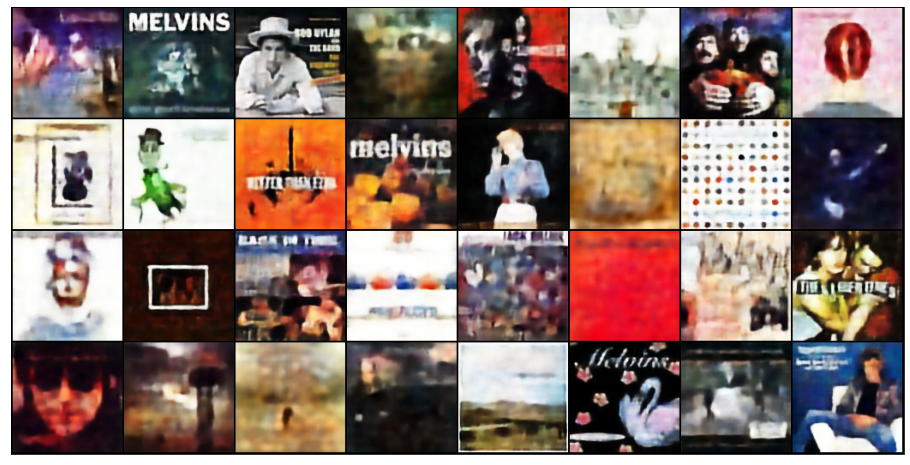

Iteration: 1500/1620
Loss: 1495589.8750, BCE Loss: 1462125.2500, DKL Loss: 33464.6250


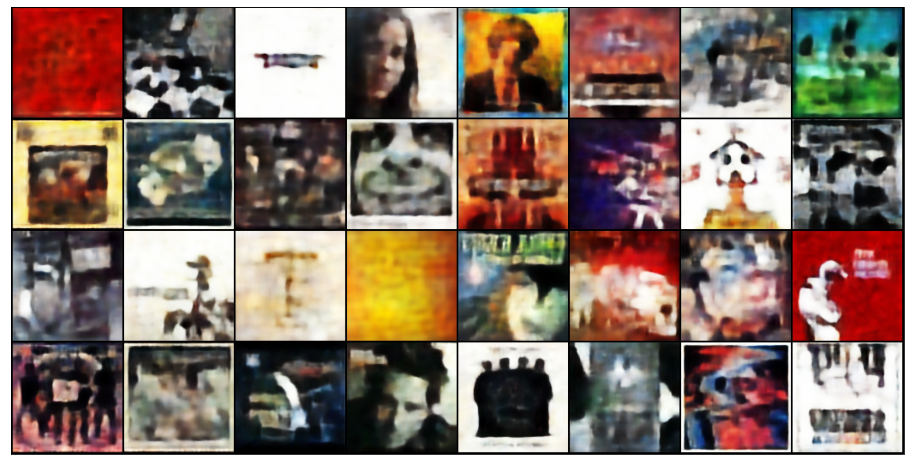

EVALUATING...
Iteration: 0/127
Iteration: 48/127
Iteration: 96/127
tensor(1570767.1250)
[tensor(1668636.1250), tensor(1588905.6250), tensor(1570767.1250), tensor(1604790.2500), tensor(1609906.1250), tensor(1582542.2500), tensor(1583079.5000), tensor(1581197.6250), tensor(1580954.2500), tensor(1575150.5000), tensor(1648844.3750), tensor(1614905.1250), tensor(1596252.), tensor(1621397.8750, device='cuda:0'), tensor(1617219.8750, device='cuda:0')]
9
2




  4%|▍         | 2/50 [10:26<4:10:43, 313.41s/it]

9
TRAINING... Epoch:  10
Iteration: 0/1620
Loss: 1586839.0000, BCE Loss: 1553208.8750, DKL Loss: 33630.1484


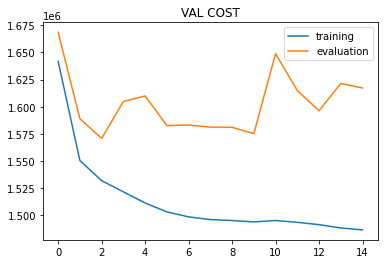

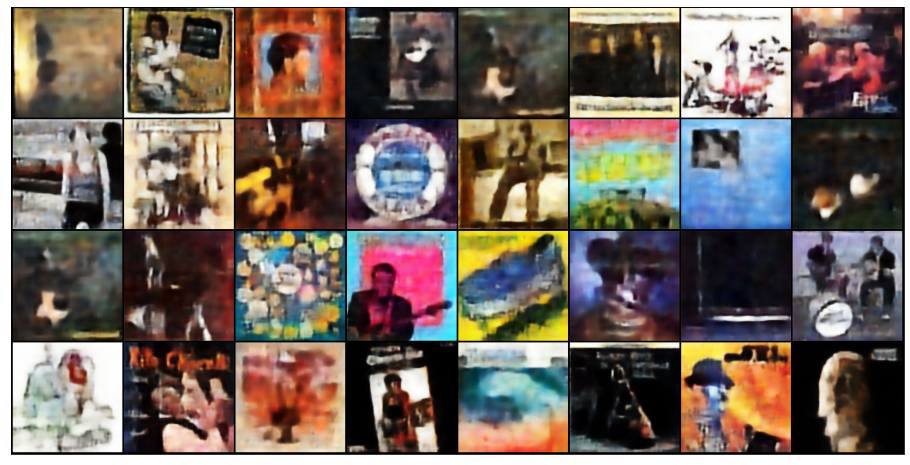

Iteration: 150/1620
Loss: 1580706.0000, BCE Loss: 1550839.0000, DKL Loss: 29866.9844


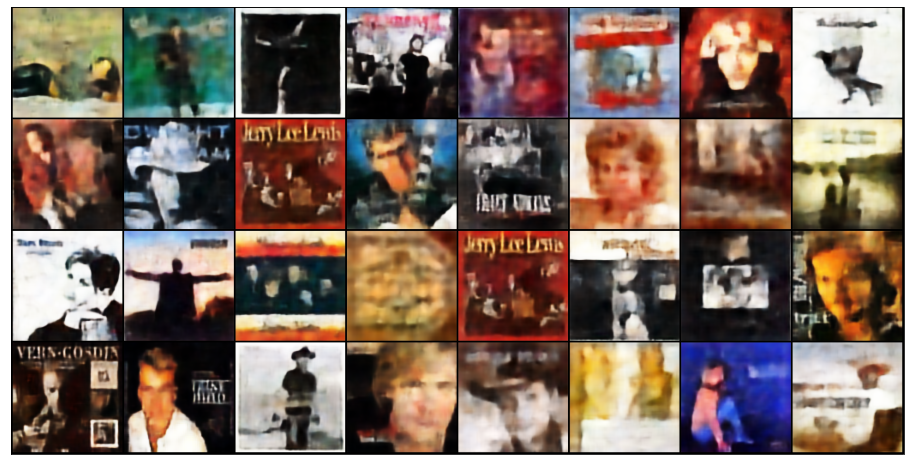

Iteration: 300/1620
Loss: 1374967.5000, BCE Loss: 1343926.5000, DKL Loss: 31040.9492


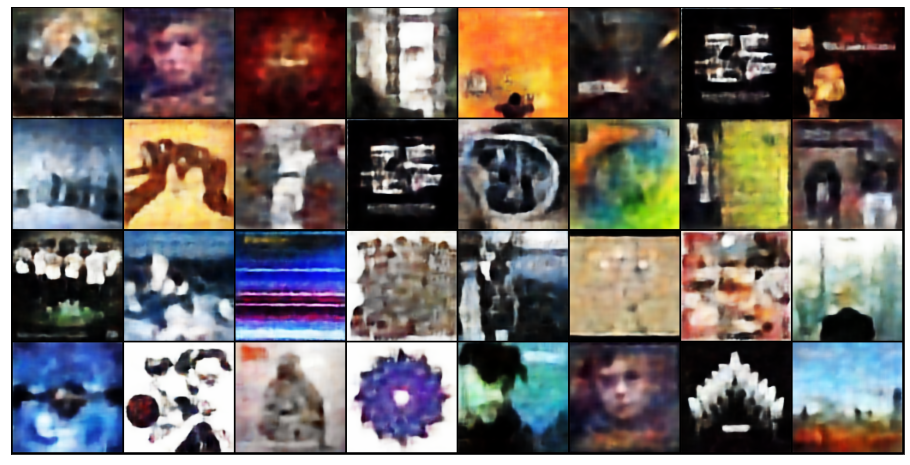

Iteration: 450/1620
Loss: 1559406.2500, BCE Loss: 1529900.8750, DKL Loss: 29505.3770


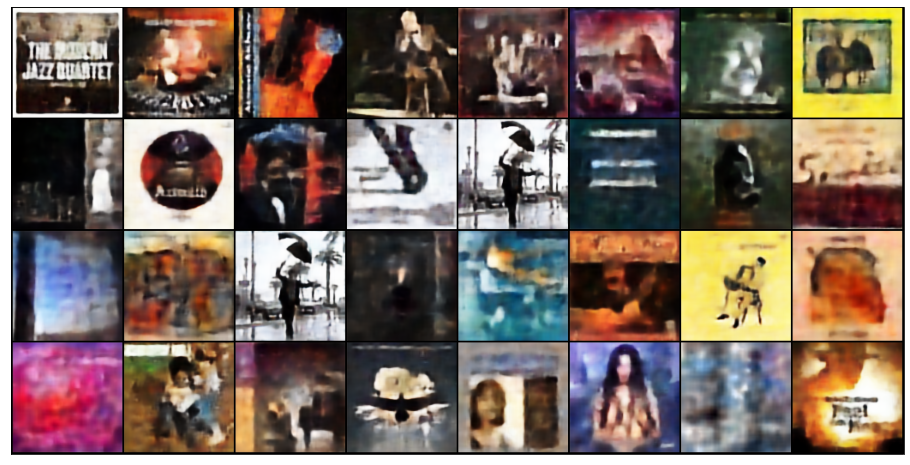

Iteration: 600/1620
Loss: 1520609.7500, BCE Loss: 1489465.7500, DKL Loss: 31144.0566


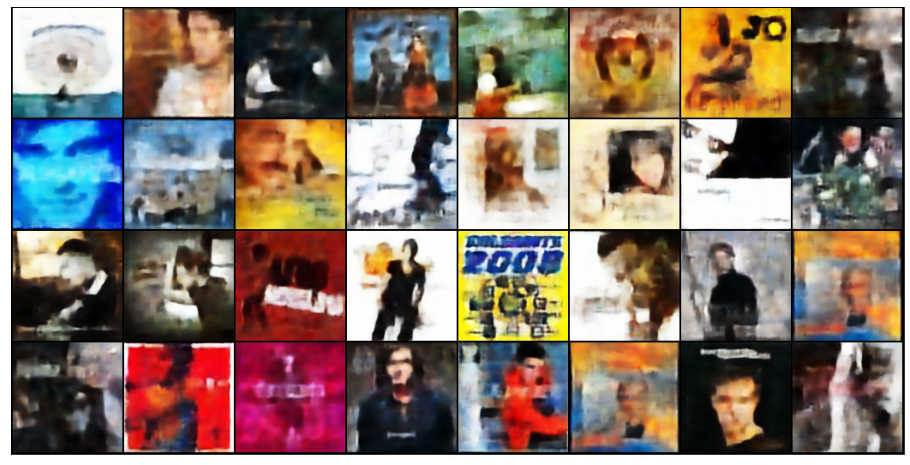

Iteration: 750/1620
Loss: 1483115.3750, BCE Loss: 1454649.7500, DKL Loss: 28465.6367


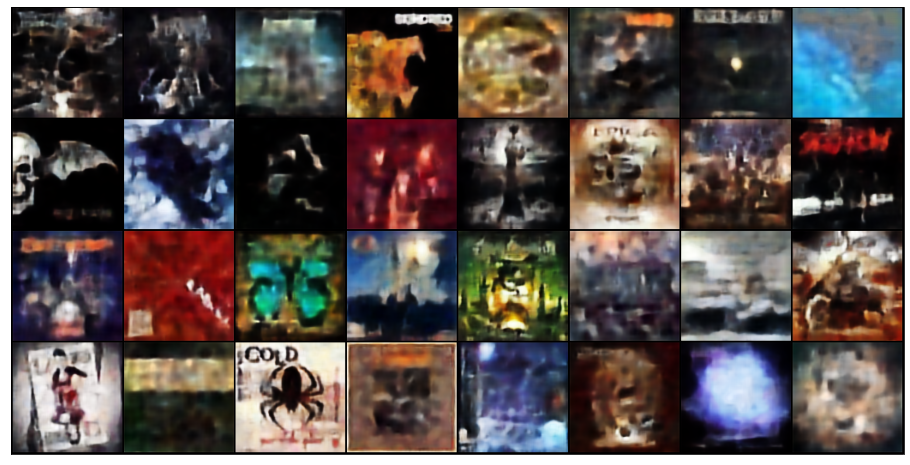

Iteration: 900/1620
Loss: 1549521.7500, BCE Loss: 1520792.8750, DKL Loss: 28728.8535


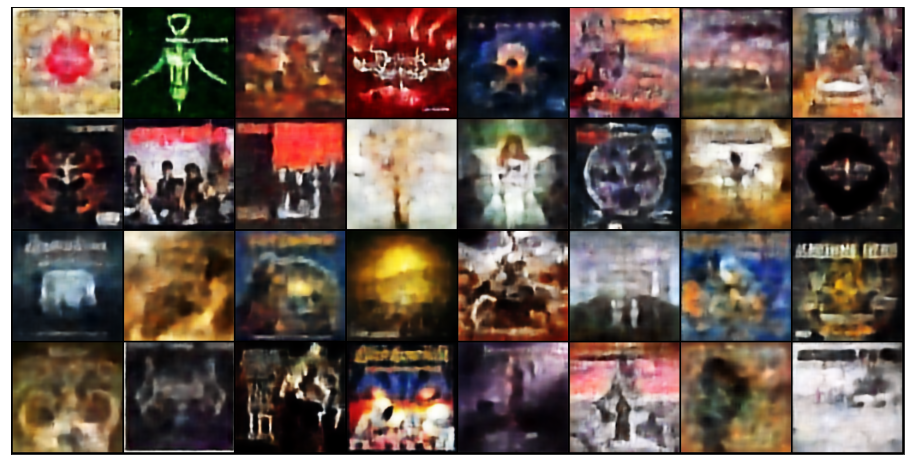

Iteration: 1050/1620
Loss: 1539136.6250, BCE Loss: 1505818.0000, DKL Loss: 33318.6406


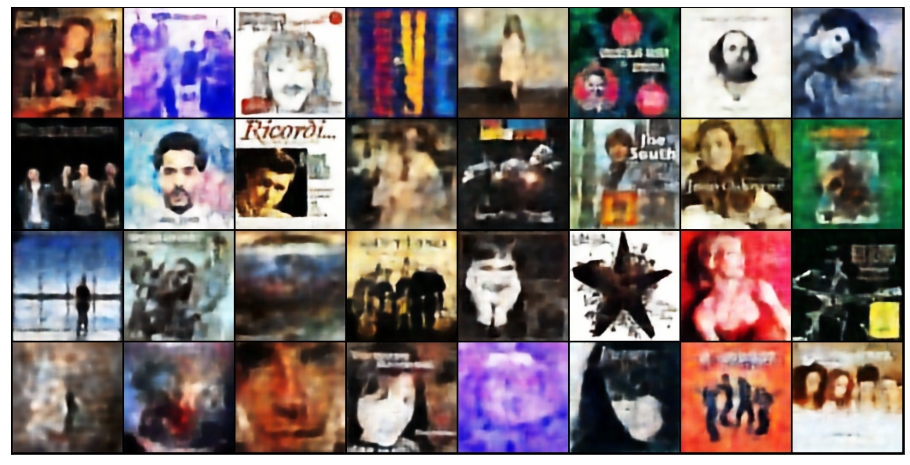

Iteration: 1200/1620
Loss: 1473830.1250, BCE Loss: 1439690.2500, DKL Loss: 34139.8398


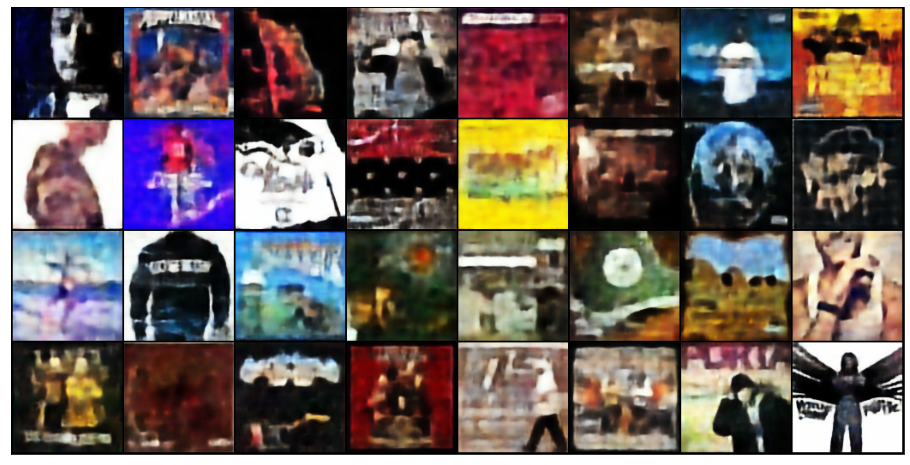

Iteration: 1350/1620
Loss: 1446931.3750, BCE Loss: 1415397.0000, DKL Loss: 31534.3691


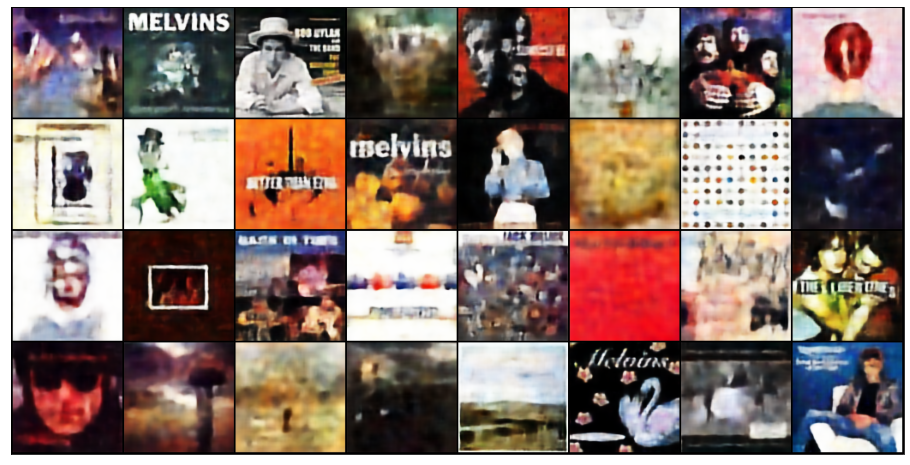

Iteration: 1500/1620
Loss: 1495251.3750, BCE Loss: 1461578.5000, DKL Loss: 33672.8516


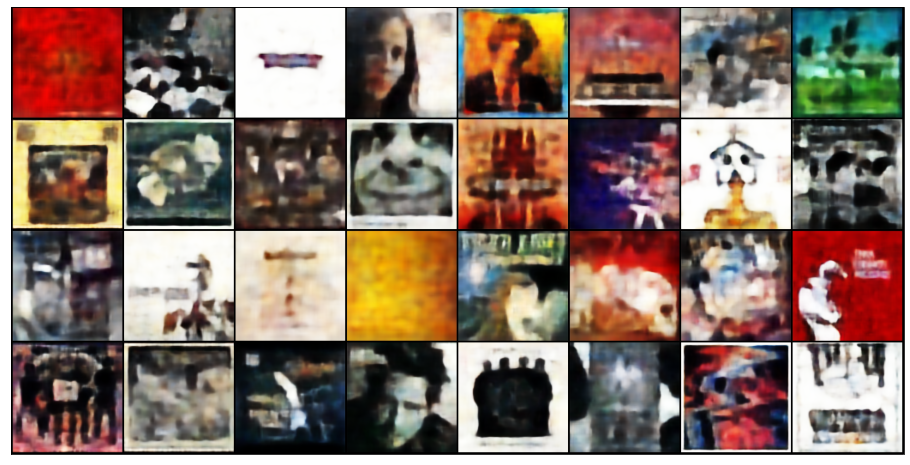

EVALUATING...
Iteration: 0/127
Iteration: 48/127
Iteration: 96/127
tensor(1570767.1250)
[tensor(1668636.1250), tensor(1588905.6250), tensor(1570767.1250), tensor(1604790.2500), tensor(1609906.1250), tensor(1582542.2500), tensor(1583079.5000), tensor(1581197.6250), tensor(1580954.2500), tensor(1575150.5000), tensor(1648844.3750), tensor(1614905.1250), tensor(1596252.), tensor(1621397.8750, device='cuda:0'), tensor(1617219.8750, device='cuda:0'), tensor(1612657.7500, device='cuda:0')]
10
3




  6%|▌         | 3/50 [15:39<4:05:26, 313.34s/it]

10
TRAINING... Epoch:  11
Iteration: 0/1620
Loss: 1585014.0000, BCE Loss: 1551282.5000, DKL Loss: 33731.4922


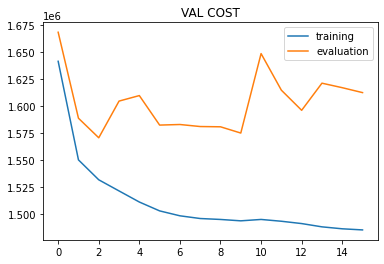

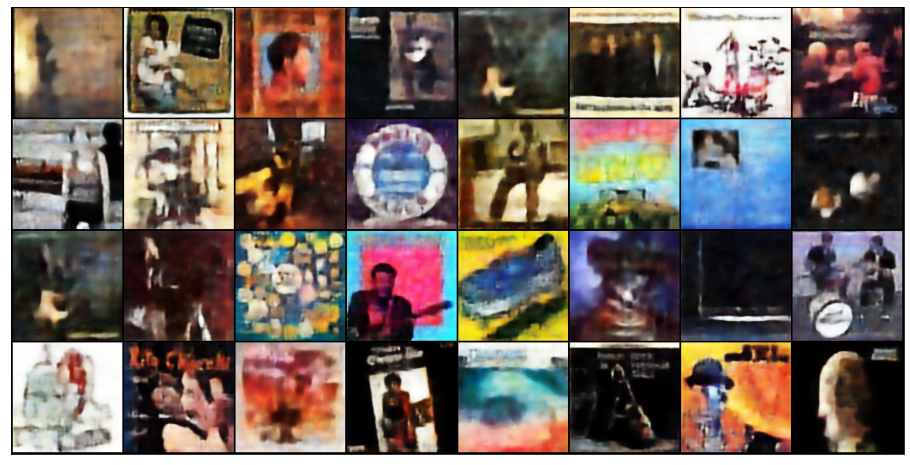

Iteration: 150/1620
Loss: 1580461.5000, BCE Loss: 1550628.7500, DKL Loss: 29832.7832


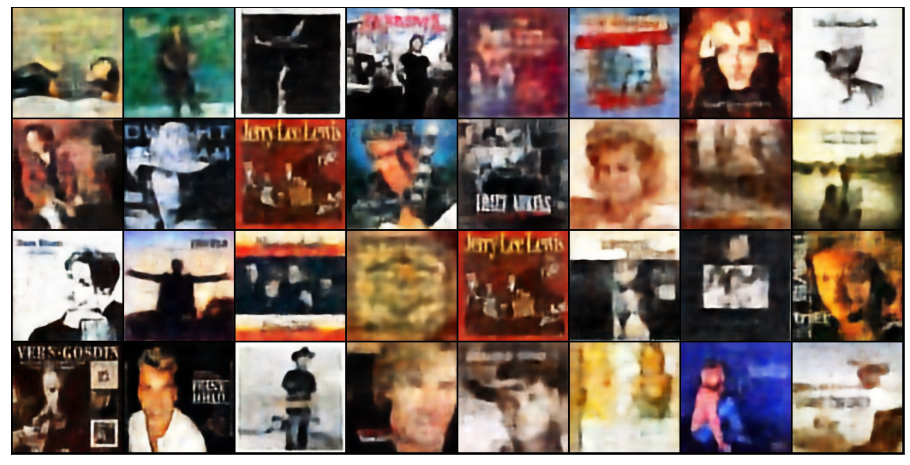

Iteration: 300/1620
Loss: 1374626.2500, BCE Loss: 1343458.2500, DKL Loss: 31167.9707


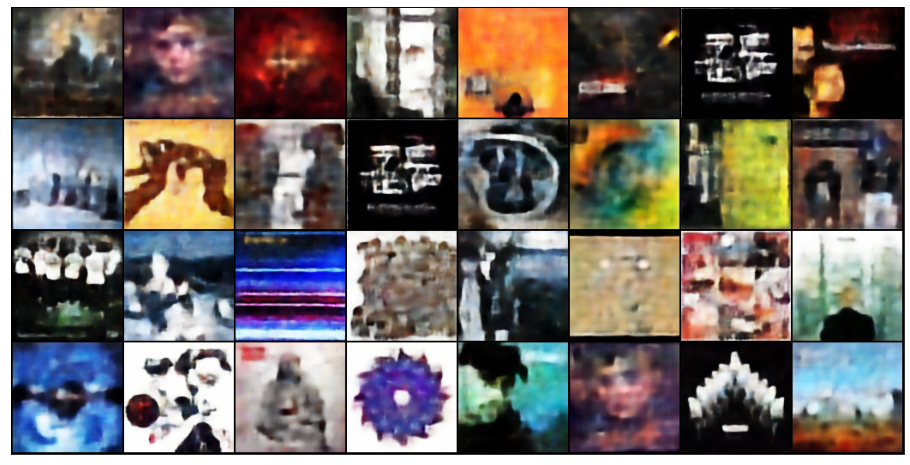

Iteration: 450/1620
Loss: 1558363.5000, BCE Loss: 1528904.0000, DKL Loss: 29459.4688


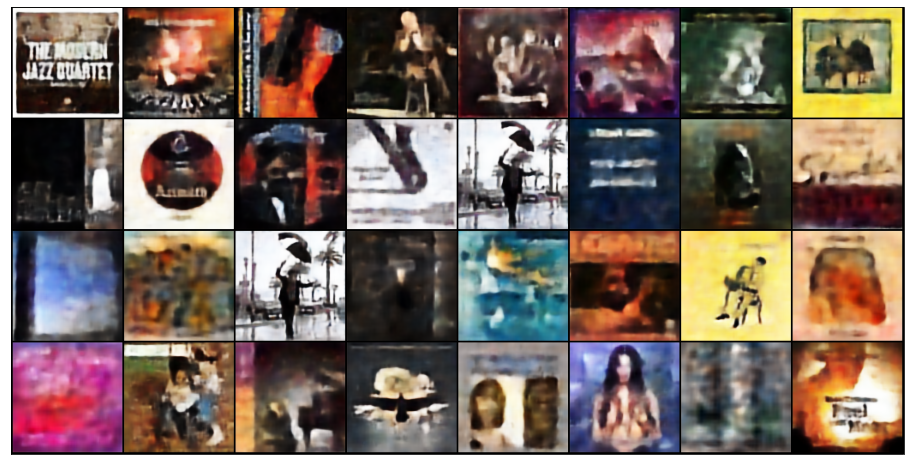

Iteration: 600/1620
Loss: 1519891.0000, BCE Loss: 1488839.1250, DKL Loss: 31051.9258


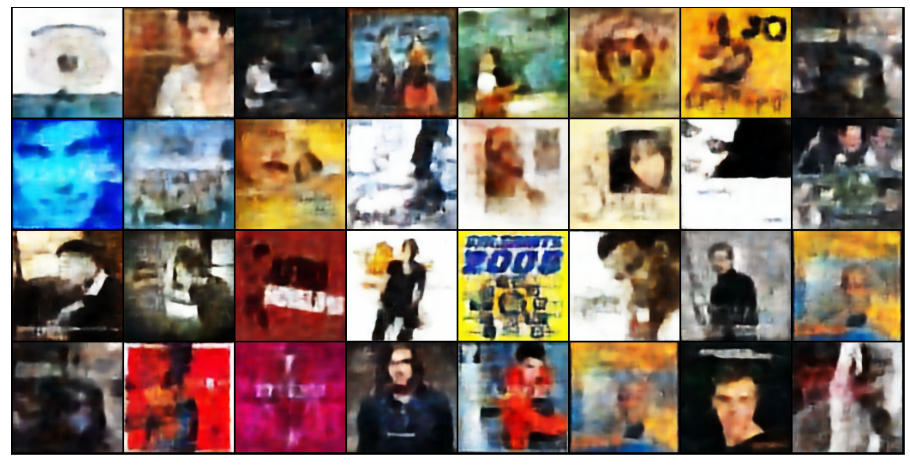

Iteration: 750/1620
Loss: 1482429.1250, BCE Loss: 1453789.0000, DKL Loss: 28640.1484


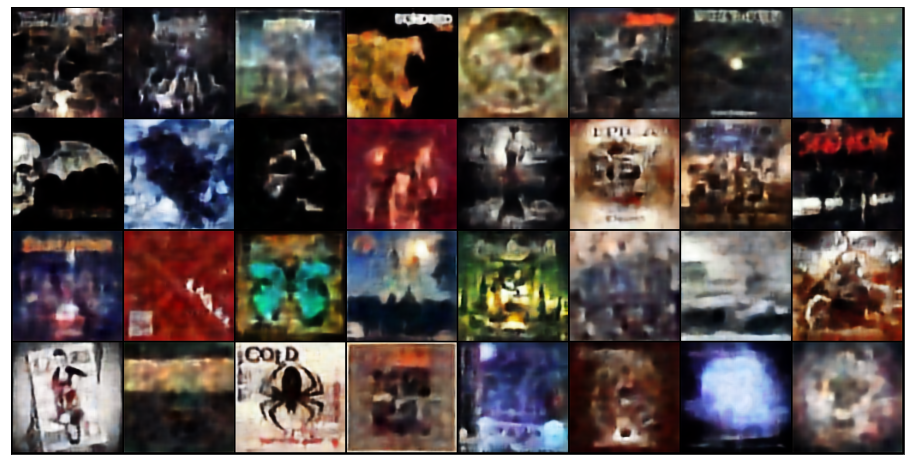

Iteration: 900/1620
Loss: 1549562.0000, BCE Loss: 1520552.5000, DKL Loss: 29009.5605


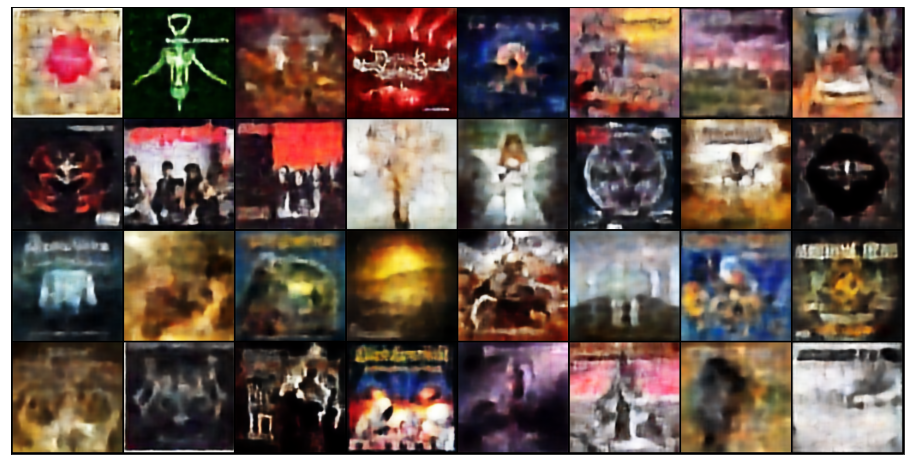

Iteration: 1050/1620
Loss: 1538619.7500, BCE Loss: 1505297.8750, DKL Loss: 33321.8672


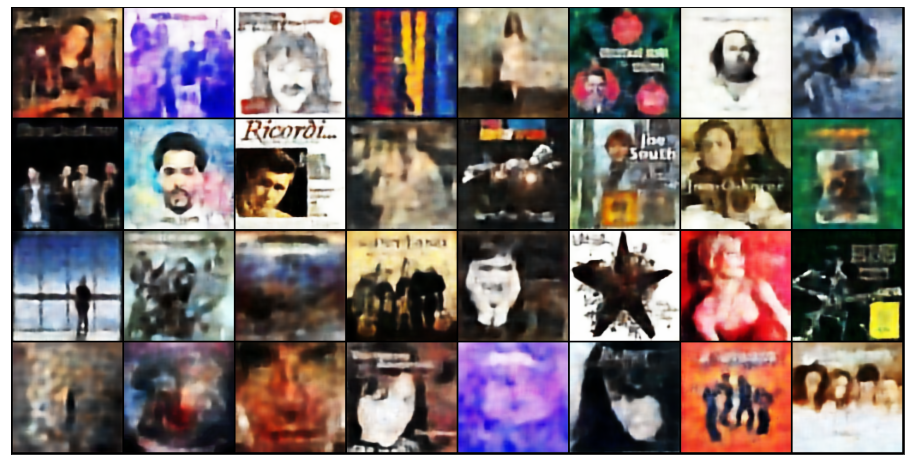

Iteration: 1200/1620
Loss: 1473183.3750, BCE Loss: 1439066.2500, DKL Loss: 34117.0977


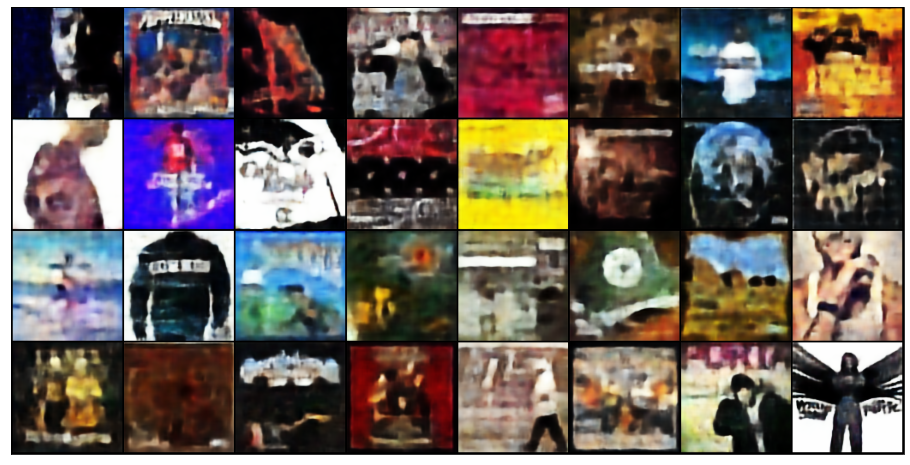

Iteration: 1350/1620
Loss: 1446531.0000, BCE Loss: 1414777.2500, DKL Loss: 31753.7734


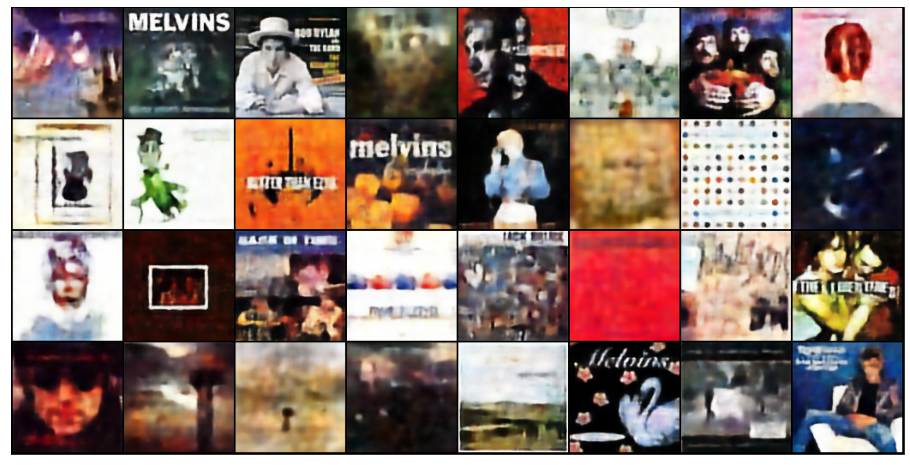

Iteration: 1500/1620
Loss: 1494011.8750, BCE Loss: 1460437.8750, DKL Loss: 33574.0547


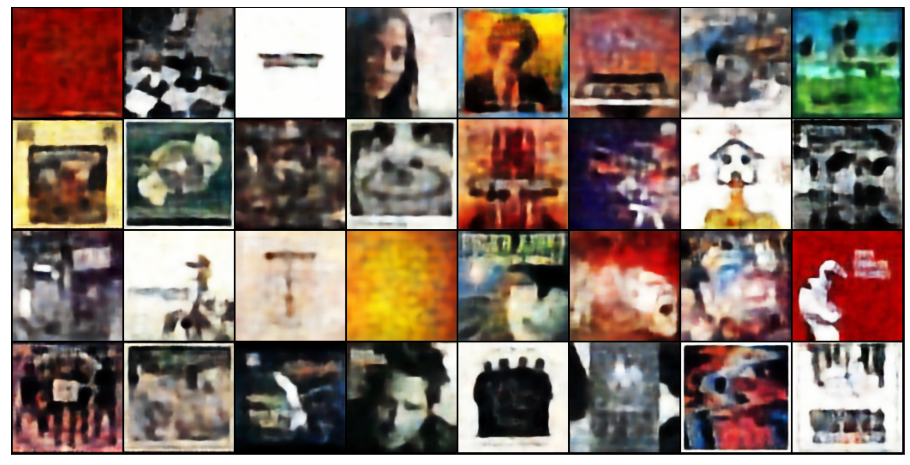

EVALUATING...
Iteration: 0/127
Iteration: 48/127
Iteration: 96/127
tensor(1570767.1250)
[tensor(1668636.1250), tensor(1588905.6250), tensor(1570767.1250), tensor(1604790.2500), tensor(1609906.1250), tensor(1582542.2500), tensor(1583079.5000), tensor(1581197.6250), tensor(1580954.2500), tensor(1575150.5000), tensor(1648844.3750), tensor(1614905.1250), tensor(1596252.), tensor(1621397.8750, device='cuda:0'), tensor(1617219.8750, device='cuda:0'), tensor(1612657.7500, device='cuda:0'), tensor(1589649.8750, device='cuda:0')]
11
4
Training stopped


In [16]:
epoch = 0
cost_list_train = []
cost_list_val = []
lr_list = []
n_epochs = 50
epoch_since_min = 0
m = sys.maxsize

checkpoint = True
if checkpoint:
  checkpoint = torch.load('/content/drive/My Drive/models/cvae.pth', map_location=lambda storage, loc: storage)
  model.load_state_dict(checkpoint['model_state_dict'])
  optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
  epoch = checkpoint['epoch']
  lr_list = checkpoint['lr_list']
  cost_list_train = checkpoint['cost_list_train']
  cost_list_val = checkpoint['cost_list_val']
  m = min(cost_list_val)

change_lr = True
if change_lr:
  lr = 1e-4
  optimizer.param_groups[0]['lr'] = lr


for epoch in tqdm.tqdm(range(epoch,n_epochs+epoch)):
    COST_TRAIN = 0   
    lr_list.append(lr)
    model.train()
    # ------------------------------------------- TRAINING -----------------------------------------#
    print('TRAINING... Epoch: ',epoch)
    for i, data in enumerate(train_loader):
        audio_x, cover = data
        cover_x, _ = cover    
        cover_x = cover_x.float().to(device)
        audio_x = audio_x.float().to(device)


        # Forward
        mu, logvar, output = model.forward(cover_x, audio_x)        
        
        bce_loss, dkl_loss, loss = loss_vae(mu, logvar, output, cover_x)
        
        # Backprop
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        COST_TRAIN+=loss.data
        if i % 150 == 0:
            print("Iteration: " + str(i) + '/' + str(len(train_loader)))
            print('Loss: {:.4f}, BCE Loss: {:.4f}, DKL Loss: {:.4f}'.format(loss.data.item(), bce_loss.data.item(), dkl_loss.data.item()))
        
            fig = plt.figure(figsize=(16, 16))
        
            ax = plt.imshow(np.transpose(vutils.make_grid(output[:32], 
                                                          padding=2, 
                                                          normalize=True, 
                                                          scale_each=True).cpu().detach().numpy(),(1,2,0)))
            ax.axes.get_xaxis().set_visible(False)
            ax.axes.get_yaxis().set_visible(False)
            plt.show(fig)
        
    #-------------------------------------- EVALUATION --------------------------------------#
    print('EVALUATING...')
    model.eval()
    COST_VAL = 0
    for i, data in enumerate(val_loader):
      audio_x, cover = data
      cover_x, _ = cover    
      cover_x = cover_x.float().to(device)
      audio_x = audio_x.float().to(device)

      mu, logvar, output = model.forward(cover_x, audio_x)

      bce_loss, dkl_loss, loss = loss_vae(mu, logvar, output, cover_x)
      COST_VAL+=loss.data
      if i % 48 == 0:
        print("Iteration: " + str(i) + '/' + str(len(val_loader)))

    cost_list_train.append(COST_TRAIN/len(train_loader))
    cost_list_val.append(COST_VAL/len(val_loader))
    

    #------------------------- CHECK VAL LOSS METHODOLOGY -----------------------------------#
    print(m)
    if cost_list_val[epoch] < m:
        m = cost_list_val[epoch]
        epoch_since_min = 0
    else:
        epoch_since_min += 1

    print(cost_list_val)
    print(epoch)
    print(epoch_since_min)

    if epoch_since_min == 4:
      print('Training stopped')
      break

    #Save model
    torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'cost_list_train': cost_list_train,
            'cost_list_val': cost_list_val,
            'lr_list': lr_list,
            }, '/content/drive/My Drive/conditional_vae/cvae_'+str(epoch)+'.pth')
   
    plt.figure()
    plt.plot(cost_list_train, label='training')
    plt.title('TRAIN COST')
    plt.plot(cost_list_val, label='evaluation')
    plt.title('VAL COST')
    plt.legend()
    print(epoch)

### Analysis 
Let's first load the train model

In [8]:
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")

model = Cvae(3,32,32, 500).to(device)

checkpoint = torch.load('/content/drive/My Drive/models/cvae.pth', map_location=lambda storage, loc: storage)
model.load_state_dict(checkpoint['model_state_dict'])
epoch = checkpoint['epoch']
cost_list_train = checkpoint['cost_list_train']
cost_list_val = checkpoint['cost_list_val']
lr_list = checkpoint['lr_list']

We find that the best model to generalize is at 9 epochs

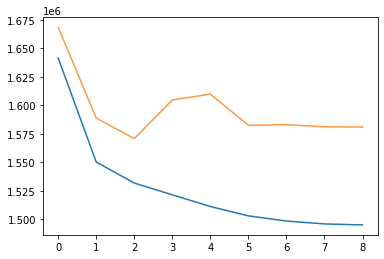

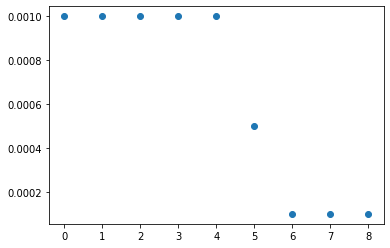

In [9]:
plt.plot(cost_list_train)
plt.plot(cost_list_val, alpha=0.8)

epochs = []
for i in range(len(cost_list_train)):
  epochs.append(i)
plt.figure()
plt.scatter(epochs, lr_list)

Loss: 1553718.5000, BCE Loss: 1524042.5000, DKL Loss: 29675.9883


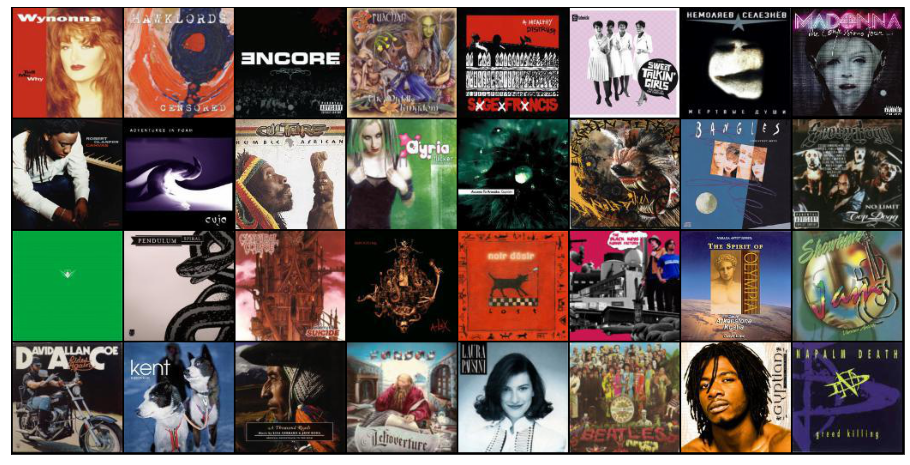

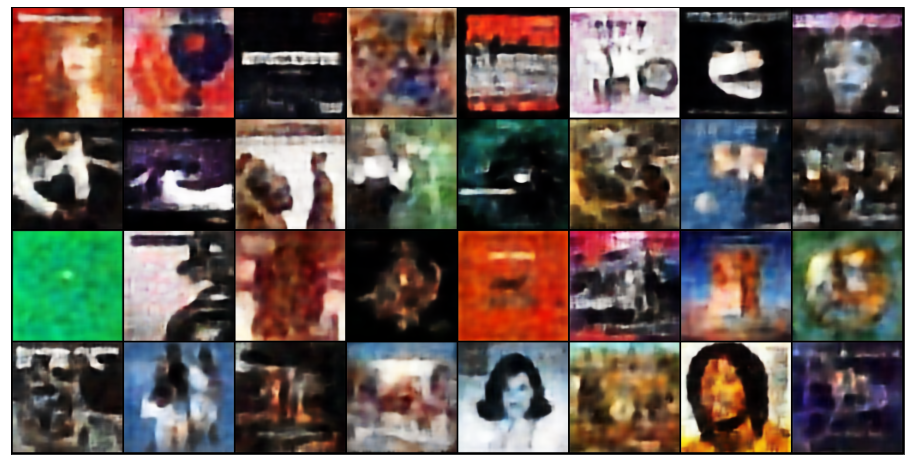

In [24]:
# ------------------------------------------------ ANALYSIS ----------------------------------------------------------#
model.eval()
for i, data in enumerate(val_loader):
    audio_x, cover = data
    cover_x, _ = cover    
    cover_x = cover_x.float().to(device)
    audio_x = audio_x.float().to(device)

    mu, logvar, output = model.forward(cover_x, audio_x)
    bce_loss, dkl_loss, loss = loss_vae(mu, logvar, output, cover_x)
    print('Loss: {:.4f}, BCE Loss: {:.4f}, DKL Loss: {:.4f}'.format(loss.data.item(), bce_loss.data.item(), dkl_loss.data.item()))


    #Plot batch of real images 
    fig = plt.figure(figsize=(16, 16))
    ax = plt.imshow(np.transpose(vutils.make_grid(cover_x[:32], 
                                                          padding=2, 
                                                          normalize=True, 
                                                          scale_each=True).cpu().detach().numpy(),(1,2,0)))
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    plt.show(fig)

    #Plot batch of output images
    fig = plt.figure(figsize=(16, 16))
    ax = plt.imshow(np.transpose(vutils.make_grid(output[:32], 
                                                          padding=2, 
                                                          normalize=True, 
                                                          scale_each=True).cpu().detach().numpy(),(1,2,0)))
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    plt.show(fig)

    break


Now, we will try to generate a new blues album artwork. What we are going to do is input all the blues album covers and save the latent space encodings in an array. We then are going to calculate the centroid of all the blues album cover. This way, we should be able to generate a blues album cover.

In [10]:
# We create the mean and variance vectors
mu_blues = np.zeros((2529,500))
logvar_blues = np.zeros((2529,500))

# We define our dataloader
cover_blues_train = 'multimodal_dataset/audio-cover_dataset/cover/train/'
cover_blues = datasets.ImageFolder(root=cover_blues_train,
                                transform=transforms.Compose([
                               transforms.ToTensor(),
                           ]))
#Audio
audio_blues = 'multimodal_dataset/audio-cover_dataset/X_train_audio.npy'

blues_dataset = concatDataset(audio_blues, cover_blues)
blues_loader = torch.utils.data.DataLoader(dataset=blues_dataset, batch_size=1, shuffle=False, drop_last=True)


model.eval()
count = 0
last_genre = torch.tensor([0])

for i, data in enumerate(blues_loader):
  audio, cover = data
  audio_x = audio
  cover_x, genre = cover

  if genre != last_genre:
    break

  mu, logvar = model.encoder(cover_x.to(device))
  # Save each embedding in mu_blues and logvar_blues
  mu_blues[i] = mu_blues[i]+mu.cpu().detach().numpy()
  logvar_blues[i] = logvar_blues[i]+logvar.cpu().detach().numpy()

  count+=1
  last_genre = genre

print(count)

2529


In [22]:
logvar_blues_mean = np.mean(logvar_blues, axis=0)
mu_blues_mean = np.mean(mu_blues, axis=0)

We are now going to take an audio feature vector from a blues track and condition the centroid for blues album covers in the latent space with it.

Text(0.5, 1.0, 'Album cover of audio feature vector used for conditioning')

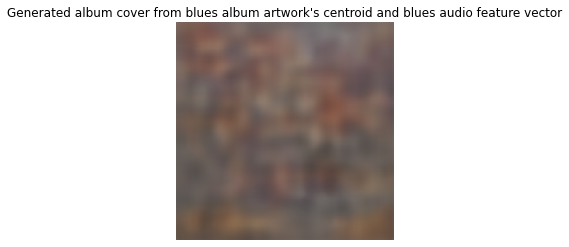

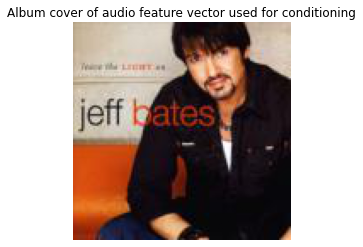

In [30]:
blues_batch = next(iter(blues_loader))
audio, cover = blues_batch
audio_blues_sample = audio
cover_blues_sample, _ = cover

def reparametrize(mu, logvar):
        std = torch.exp(0.5*torch.from_numpy(logvar))
        eps = torch.randn((1,500)) #Returns tensor same size as inpufilled with rand nº from Udistribution on interval [0,1)
        return torch.from_numpy(mu)+std*eps

z = reparametrize(mu_blues_mean, logvar_blues_mean)
reconst_img = model.decoder(z.float().to(device), audio_blues_sample.float().to(device))

# Show generated image
img = reconst_img.cpu().squeeze(0)
img = img.permute(1,2,0)
img = img.detach().numpy()
plt.imshow(img)
plt.axis('off')
plt.title("Generated album cover from blues album artwork's centroid and blues audio feature vector")

# Show album cover from audio feature vector
plt.figure()
plt.imshow(cover_x.squeeze(0).permute(1,2,0).detach().numpy())
plt.axis('off')
plt.title('Album cover of audio feature vector used for conditioning')

#### 2D latent space visualization

We are now going to check how the model is distributing different album artworks by genre in the space by using t-SNE transformation. We will transform the 500 latent space into a 2D latent space

In [11]:
# We define our dataloader only for covers
cover_path = 'multimodal_dataset/audio-cover_dataset/cover/train/'
cover_dataset = datasets.ImageFolder(root=cover_path,
                                transform=transforms.Compose([
                               transforms.ToTensor(),
                           ]))

train_loader = torch.utils.data.DataLoader(dataset=cover_dataset, batch_size=1, drop_last=True)

# Init to store all mu and logvar of train examples
mu_total = np.zeros((train_loader.__len__() ,500))
logvar_total = np.zeros((train_loader.__len__() ,500))

# Set model to evaluation
model.eval()

# Store all mu and logvar from train set
for i, data in enumerate(train_loader):
  data, data_y = data
  mu, logvar = model.encoder(data.to(device))
  mu_total[i] = mu_total[i]+mu.cpu().detach().numpy()
  logvar_total[i] = logvar_total[i]+logvar.cpu().detach().numpy()

In [32]:
from sklearn.manifold import TSNE

m = TSNE(n_components=2, random_state=0)
mu_total = m.fit_transform(mu_total)
logvar_total = m.fit_transform(logvar_total)


We now count the different samples for each of the genres. With the number of samples per genre we can specifically plot the latent space samples for each of the genres

In [19]:
genre_samples = {}
count = 0
last_genre = ''
for root, dirs, files in os.walk('multimodal_dataset/audio-cover_dataset/cover/train'):
  for file in files:
    genre = root.replace(os.sep, '/').split('/')[3]
    if genre != last_genre:
      genre_samples[last_genre] = count
      count = 0
    last_genre =  root.replace(os.sep, '/').split('/')[3]
    count+=1

We only plot the 2D latent space samples for: blues, country and electronic for a better visualization

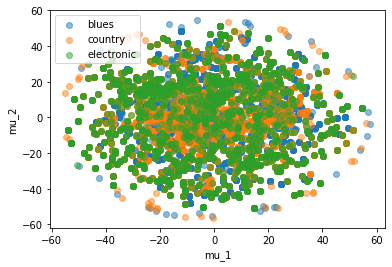

In [21]:
plt.scatter(mu_total[:genre_samples['blues']][:,0], 
            mu_total[:genre_samples['blues']][:,1], 
            label='blues', alpha=0.5)
plt.scatter(mu_total[genre_samples['blues']:genre_samples['country']][:,0], 
            mu_total[genre_samples['blues']:genre_samples['country']][:,1], 
            label='country', alpha=0.5)
plt.scatter(mu_total[genre_samples['country']:genre_samples['electronic']][:,0],
            mu_total[genre_samples['country']:genre_samples['electronic']][:,1],
             label='electronic', alpha=0.5)
plt.xlabel('mu_1')
plt.ylabel('mu_2')
plt.xlabel('mu_1')
plt.ylabel('mu_2')
plt.legend()